# Рынок заведений общественного питания Москвы


**Цель проекта:**
Провести исследование рынка Москвы, которое покажет самые прибыльные и популярные категории заведений общественного питания

**План исследования:**
1. Загрузить все необходимые библиотеки
2. Предобработка данных:
  - Проверить на пропуски и дубликаты, при необходимости удалить строки, удаления которых не повлияет на итоговый результат
  - Проверить на аномальные значения
  - Добавить столбцы street и is_24/7
3. Проанализировать данные
4. Расписать рекомендации с объяснением того или иного выбора
5. Детализировать исследование: открытие кофейни
6. Подготовить презентацию


<a id="Head"></a> **Оглавление:**

[Шаг 1. Загрузить данные и изучить общую информацию](#1)

[Шаг 2. Выполнить предобработку данных](#2)

[Шаг 3. Анализ данных](#3)

[Шаг 4. Выводы и рекомендации](#4)

[Шаг 5. Детализировать исследование: открытие кофейни](#5)

[Шаг 6. Презентация](#6)

# <a id="1"></a> **Шаг 1. Загрузить данные и изучить общую информацию**

[Оглавление](#Head)

In [1]:
%pip install -U kaleido -q

Note: you may need to restart the kernel to use updated packages.


In [2]:
#загрузим библиотеки

import pandas as pd
import datetime as dt
import json
import numpy as np
import plotly.io as pio
pio.renderers.default="png"
from IPython.display import display
from PIL import Image
from folium import Map, Choropleth
from folium import Map, Marker
from folium.plugins import MarkerCluster
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(rc={'figure.figsize':(15,10)})

In [3]:
#загрузим датасет

data = pd.read_csv('/datasets/moscow_places.csv')
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [4]:
#посмотрим кол-во и категории уникальных заведений общественного питания

data['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [5]:
print('Кол-во уникальных категорий заведений общественного питания в Москве -', data['category'].nunique())

Кол-во уникальных категорий заведений общественного питания в Москве - 8


In [6]:
#посмотрим общую информацию по датасету

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


**Много пропусков, нужно проанализировать возможно ли заполнение медианными, средними значениями или заглушкой**

# <a id="2"></a> **Шаг 2. Выполнить предобработку данных**

[Оглавление](#Head)

In [7]:
#посчитаем кол-во дубликатов

print ('Количество дубликатов -', data.duplicated().sum())

Количество дубликатов - 0


In [11]:
data['avg_bill'].value_counts()

Средний счёт:1000–1500 ₽          241
Средний счёт:1500–2000 ₽          120
Средний счёт:300–500 ₽             90
Средний счёт:500–1000 ₽            78
Средний счёт:1500–2500 ₽           68
Средний счёт:700–1000 ₽            50
Средний счёт:от 1500 ₽             48
Цена чашки капучино:239–274 ₽      43
Средний счёт:1000–2000 ₽           43
Средний счёт:1000 ₽                43
Средний счёт:1500 ₽                43
Средний счёт:300 ₽                 42
Средний счёт:1000–1200 ₽           42
Средний счёт:от 500 ₽              41
Средний счёт:200–300 ₽             41
Средний счёт:2000–2500 ₽           41
Средний счёт:700–1500 ₽            40
Средний счёт:300–400 ₽             39
Средний счёт:500–700 ₽             38
Средний счёт:250–350 ₽             37
Средний счёт:500–1500 ₽            35
Цена чашки капучино:от 60 ₽        33
Средний счёт:500 ₽                 33
Средний счёт:400–600 ₽             33
Средний счёт:200–400 ₽             32
Средний счёт:до 1000 ₽             32
Цена чашки к

In [12]:
#проверим датасет после заполнения пропусков

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [13]:
#проверим датасет на аномальные значения

data.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,8406.000000,8406.000000,8406.000000,3149.000000,535.000000,8406.000000,4795.000000
mean,55.750109,37.608570,4.229895,958.053668,174.721495,0.381275,108.421689
std,0.069658,0.098597,0.470348,1009.732845,88.951103,0.485729,122.833396
min,55.573942,37.355651,1.000000,0.000000,60.000000,0.000000,0.000000
25%,55.705155,37.538583,4.100000,375.000000,124.500000,0.000000,40.000000
50%,55.753425,37.605246,4.300000,750.000000,169.000000,0.000000,75.000000
75%,55.795041,37.664792,4.400000,1250.000000,225.000000,1.000000,140.000000
max,55.928943,37.874466,5.000000,35000.000000,1568.000000,1.000000,1288.000000


**В полях middle_avg_bill и seats минимальное значение = 0, что странно. Так же в поле seats подозрительно максимальное значение = 1288, что наводит на мысль, что это рестораны на базе гостиниц или залы для конференций, ценности при анализе не представляют**

In [14]:
#проверим поле middle_avg_bill

data[data['middle_avg_bill'] == 0]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
3688,Кофемания,кофейня,"Москва, улица Новый Арбат, 19",Центральный административный округ,"ежедневно, круглосуточно",55.752136,37.587784,4.5,высокие,Средний счёт:от 0 ₽,0.0,NaN,1,200.0


**Одно значение, оставляем**

In [15]:
#проверим поле seats

data[data['seats'] == 0]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
84,Meat Doner Kebab,булочная,"Москва, улица Лескова, 22",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.896987,37.608126,4.5,NaN,Средний счёт:300 ₽,300.0,NaN,0,0.0
177,Арамье,булочная,"Москва, улица 800-летия Москвы, 22, корп. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.879392,37.556832,4.0,NaN,NaN,NaN,NaN,1,0.0
196,Донер-Шашлык,ресторан,"Москва, улица Лескова, 22",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.896962,37.608300,4.5,NaN,NaN,NaN,NaN,0,0.0
203,Тандыр № 1,кафе,"Москва, улица Лескова, 22Г",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.895615,37.611049,4.0,NaN,NaN,NaN,NaN,1,0.0
211,Неаполитан пицца,кафе,"Москва, улица Пришвина, 23",Северо-Восточный административный округ,"ежедневно, 12:00–23:00",55.885416,37.604650,4.3,NaN,NaN,NaN,NaN,0,0.0
266,Пекарня&Донер,булочная,"Москва, Широкая улица, 21",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.887751,37.672475,4.1,NaN,NaN,NaN,NaN,0,0.0
284,Центр Плов,кафе,"Москва, Широкая улица, 16А",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.887348,37.662315,4.2,NaN,NaN,NaN,NaN,0,0.0
290,Шаурма,кафе,"Москва, Осташковская улица, 7, корп. 1",Северо-Восточный административный округ,NaN,55.877350,37.679414,3.3,NaN,NaN,NaN,NaN,0,0.0
306,Everest Coffee,кофейня,"Москва, Сходненская улица, 50",Северо-Западный административный округ,"пн-чт 08:00–22:00; пт 08:00–23:00; сб,вс 09:00–23:00",55.847770,37.440586,4.9,средние,Цена чашки капучино:200–300 ₽,NaN,250.0,0,0.0
337,Пекарня Маковка,пиццерия,"Москва, Сходненская улица, 35, корп. 1",Северо-Западный административный округ,"ежедневно, 08:00–22:00",55.848505,37.439135,4.9,NaN,NaN,NaN,NaN,0,0.0


In [16]:
print ('Доля заведений с нулевыми посадочными местами -', round(data[data['seats'] == 0]['seats'].count()/data['seats'].count(), 2))

Доля заведений с нулевыми посадочными местами - 0.03


**3% и скорее всего это заведения без посадочных мест, оставим**

In [17]:
print('Кол-во заведений свыше 500 посадочных мест -',data[data['seats'] > 500]['seats'].count())

Кол-во заведений свыше 500 посадочных мест - 56


**Согласно данным в сети вместимость одного из самых больщих ресторанов Москвы до 500 чел., ограничим датасет до 500 посадочных мест, так как нам нужны популярные и проходимые заведения на каждый день**

In [18]:
#ограничим датасет

df = data[(data['seats'] <= 500)|(pd.isnull(data['seats']) == True)]
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [19]:
print ('Доля удаленных заведений -', round(data[data['seats'] > 500]['seats'].count()/data['seats'].count(), 2))

Доля удаленных заведений - 0.01


In [20]:
#посмотрим еще раз на данные нового датасета

df.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,8350.000000,8350.000000,8350.000000,3131.000000,529.000000,8350.000000,4739.000000
mean,55.750148,37.608880,4.229760,956.103801,174.725898,0.380719,100.110994
std,0.069716,0.098503,0.471166,1010.722276,89.225235,0.485593,92.109557
min,55.573942,37.355651,1.000000,0.000000,60.000000,0.000000,0.000000
25%,55.705337,37.539267,4.100000,375.000000,125.000000,0.000000,40.000000
50%,55.753363,37.605608,4.300000,750.000000,169.000000,0.000000,72.000000
75%,55.795017,37.664912,4.400000,1250.000000,225.000000,1.000000,130.000000
max,55.928943,37.874466,5.000000,35000.000000,1568.000000,1.000000,500.000000


**При ограничении таблицы местами вместимостью до 500 мест, потеря данных составила 1%**

In [21]:
#добавим столбцы street и is_24/7

df.insert(3, 'street', df['address'].str.split(', ').apply(lambda x: x[1]), True)
df.head()

,name,category,address,street,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",улица Дыбенко,Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",улица Дыбенко,Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Клязьминская улица,Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",улица Маршала Федоренко,Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Правобережная улица,Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [22]:
def hours_24(value):
    try:
        if ('круглосуточно' in value) and ('ежедневно' in value):
            return True
        return False
    except: return False

df.insert(6, 'is_24/7', df['hours'].apply(hours_24), True)
df.head()

,name,category,address,street,district,hours,is_24/7,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",улица Дыбенко,Северный административный округ,"ежедневно, 10:00–22:00",False,55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",улица Дыбенко,Северный административный округ,"ежедневно, 10:00–22:00",False,55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Клязьминская улица,Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",False,55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",улица Маршала Федоренко,Северный административный округ,"ежедневно, 09:00–22:00",False,55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Правобережная улица,Северный административный округ,"ежедневно, 10:00–22:00",False,55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


<b>Промежуточный вывод:</b>

1. дубликатов нет;

2. есть пропуски в middle_avg_bill, middle_coffee_cup, hours, price, avg_bill и seats, достоверными данным заполнить нельзя, поэтому отсавим значение Nan;

3. ограничили таблицу заведениями вместительностью менее 500 посадочных мест, потеря данных составила 1%. Свыше 500 посадочных мест являются ресторанами на базе гостиниц или залами для конференций, ценности при анализе не представляют.</div>

# <a id="3"></a>**Шаг 3. Анализ данных**

[Оглавление](#Head)

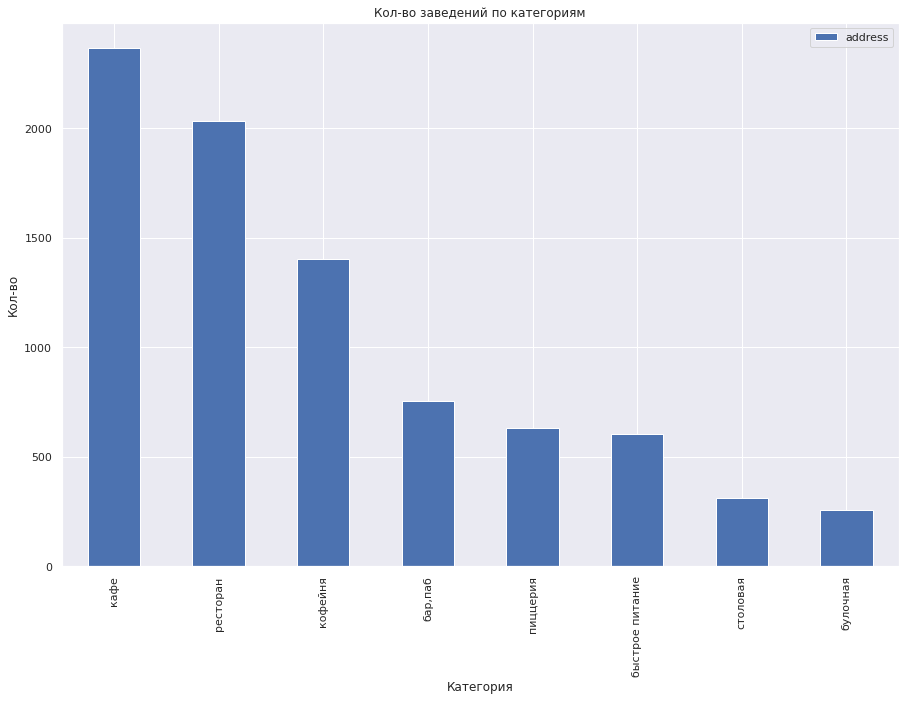

In [23]:
#проанализируем типы заведений и построим график по кол-ву
(
    df.pivot_table(index='category', values='address', aggfunc='count')
    .reset_index()
    .sort_values(by='address', ascending=False)
    .plot(kind='bar', x='category', y='address')
)
plt.title('Кол-во заведений по категориям')
plt.xlabel('Категория')
plt.ylabel('Кол-во')
plt.show()

**Список типов по кол-ву заведений: кафе, рестораны, кофейни, бары/пабы, пиццерии и в конце столовые с булочными**

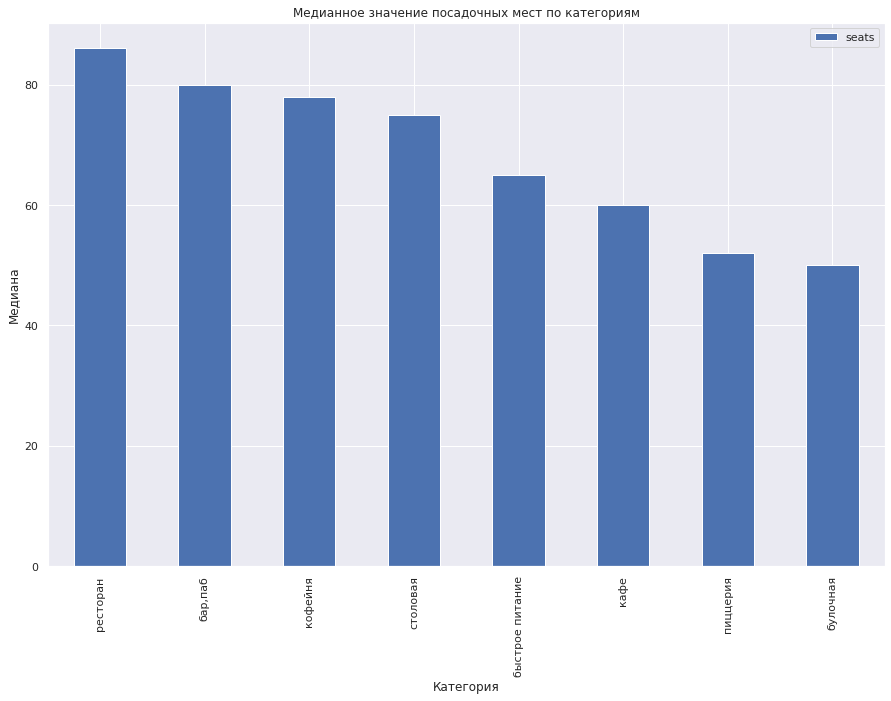

In [24]:
#изучим количество посадочных мест в местах по категориям
(
    df.pivot_table(index='category', values='seats', aggfunc='median')
    .reset_index()
    .sort_values(by='seats', ascending=False)
    .plot(kind='bar', x='category', y='seats')
)

plt.title('Медианное значение посадочных мест по категориям')
plt.xlabel('Категория')
plt.ylabel('Медиана')
plt.show()

**в список по кол-ву посадочных мест попали категории заведений - рестораны, кофейни и бары/пабы, кроме кафе и пиццерий**

In [25]:
pd.options.mode.chained_assignment = None #убрал предупреждение SettingWithCopyWarning

df.loc[df['chain'] == 1, 'chain'] = 'сетевое'
df.loc[df['chain'] == 0, 'chain'] = 'несетевое'

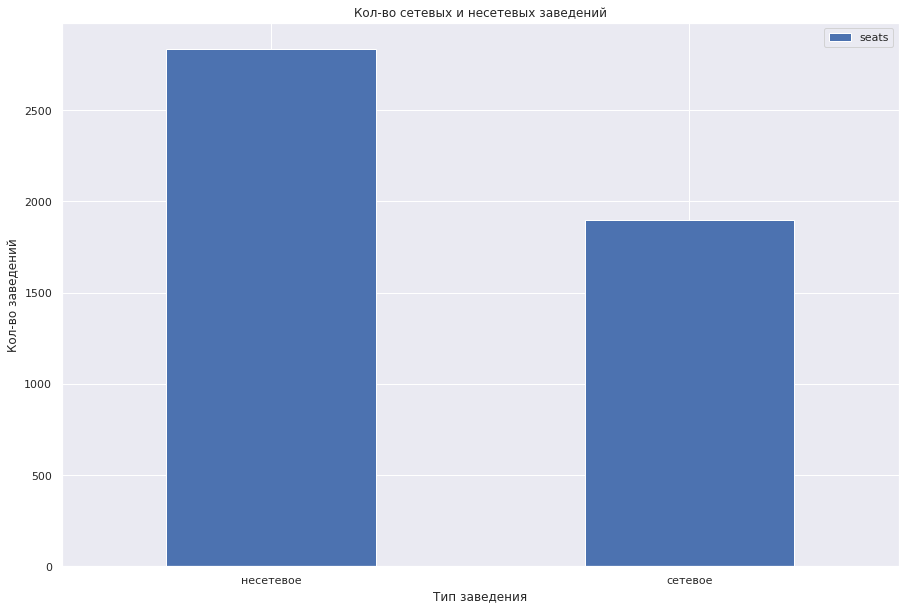

In [26]:
#проверим соотношение сетевых и несетевых заведений

df.pivot_table(index='chain', values='seats', aggfunc='count').reset_index().plot(kind='bar', x='chain', y='seats')
plt.title('Кол-во сетевых и несетевых заведений')
plt.xlabel('Тип заведения')
plt.ylabel('Кол-во заведений')
plt.xticks(rotation = 0)
plt.show()

**На 60% больше несетевых заведений**

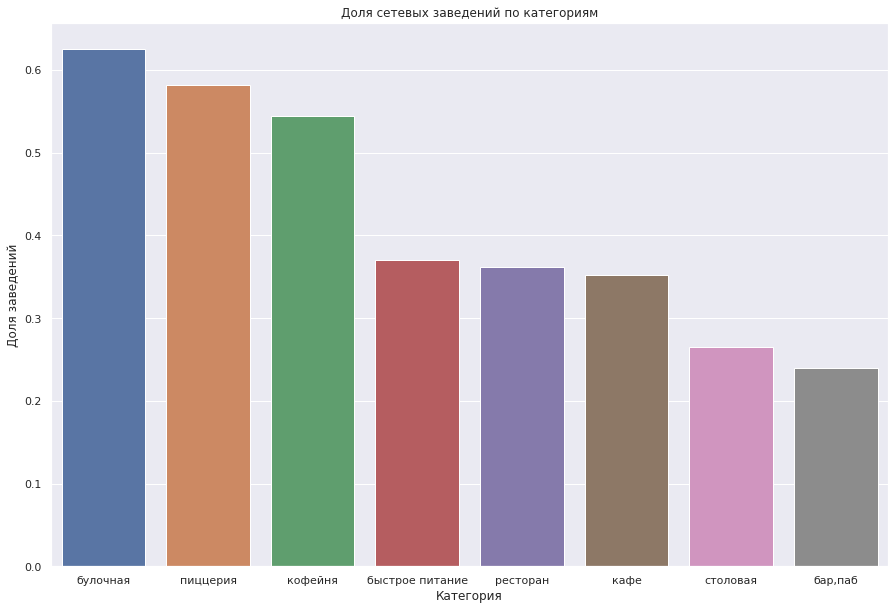

In [27]:
#посчитаем долю сетевых заведений в категориях

df_network = (
    df.query('chain == "сетевое"')
    .pivot_table(index='category', values='seats', aggfunc='count')
    .reset_index()
)

df_total = df.pivot_table(index='category', values='seats', aggfunc='count').reset_index()
df_ratio_network = df_network.merge(df_total, on='category', how='left')
df_ratio_network.columns = ['category', 'cnt_network', 'cnt_total']
df_ratio_network['ratio'] = df_ratio_network['cnt_network']/df_ratio_network['cnt_total']
df_ratio_network = df_ratio_network.sort_values(by='ratio', ascending=False)

sns.barplot(x='category', y='ratio', data=df_ratio_network)
plt.title('Доля сетевых заведений по категориям')
plt.xlabel('Категория')
plt.ylabel('Доля заведений')
plt.show()

**Топ по сетевым заведениям: кофейня, пиццерия и булочная**

In [28]:
#найдем топ-15 популярных сетей в Москве и посмотрим в разрезах по сетям, по категориям и районам

name_top_15 = (
    df.query('chain == "сетевое"')
    .groupby('name')
    .agg({'address':'count'})
    .sort_values(by='address', ascending=False)
    .head(15)
    .index
)
name_top_15

Index(['Шоколадница', 'Домино'с Пицца', 'Додо Пицца', 'One Price Coffee',
       'Яндекс Лавка', 'Cofix', 'Prime', 'Хинкальная', 'КОФЕПОРТ', 'Теремок',
       'Кулинарная лавка братьев Караваевых', 'Чайхана', 'CofeFest', 'Буханка',
       'Му-Му'],
      dtype='object', name='name')

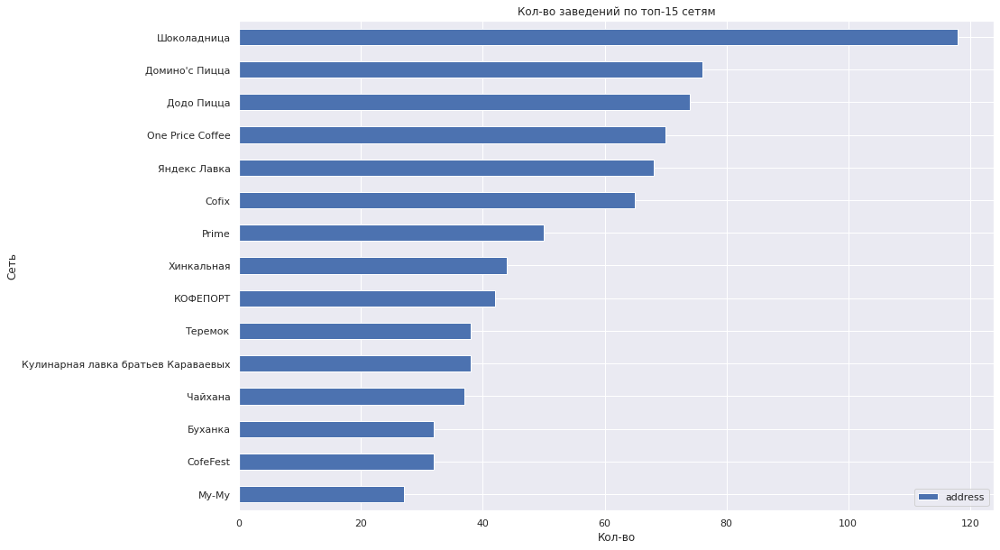

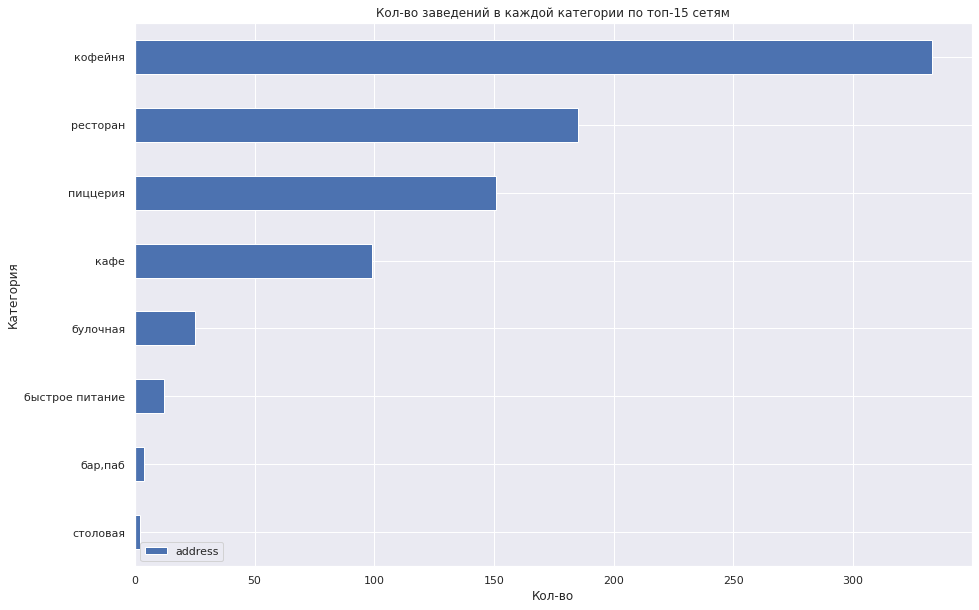

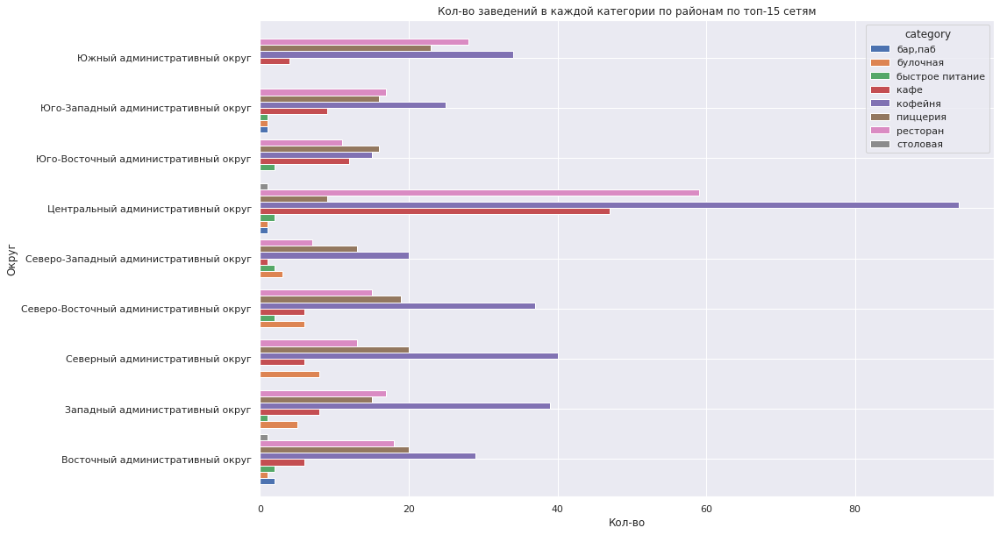

In [29]:
#по сетям

(
    df.query('name in @name_top_15')
    .pivot_table(index='name', values='address', aggfunc='count')
    .sort_values(by='address')
    .plot(kind='barh')
)
plt.title('Кол-во заведений по топ-15 сетям')
plt.xlabel('Кол-во')
plt.ylabel('Cеть')
plt.show()

#по категориям

(
    df.query('name in @name_top_15')
    .pivot_table(index='category', values='address', aggfunc='count')
    .sort_values(by='address')
    .plot(kind='barh')
)
plt.title('Кол-во заведений в каждой категории по топ-15 сетям')
plt.xlabel('Кол-во')
plt.ylabel('Категория')
plt.show()

#по районам и категориям

(
    df.query('name in @name_top_15')
    .pivot_table(index='district', columns='category', values='address', aggfunc='count')
    .plot(kind='barh', width=1)
)
plt.title('Кол-во заведений в каждой категории по районам по топ-15 сетям')
plt.xlabel('Кол-во')
plt.ylabel('Округ')
plt.show()

**Из сетевых заведений больше всего пиццерий, ресторанов и кофеен. Шоколадница самая крупная сеть, которая имеет статус кофейни** 

**В ЦАО большее кол-во сетевых заведений и разнообразие по категориям. В ЮАО лишь 4 категории сетевых заведений, но есть значительное кол-во заведений их топовых категорий. Остальные районы имеют средние результаты по насыщенности и охвату, кроме ЮВАО и СЗАО (низкая плотность).**

In [30]:
#выведем все районы и посчитаем кол-во заведений в каждой категории по районам

df['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

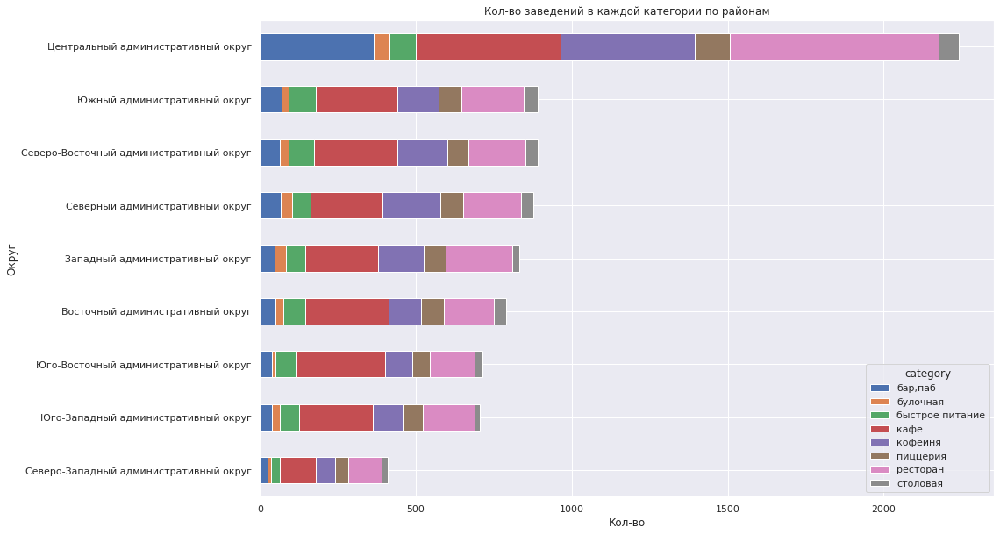

In [31]:
df_district = df.groupby('district')['name'].count().sort_values().index

(
    df.pivot_table(index='district', columns='category', values='name', aggfunc='count')
    .reindex(index=df_district)
    .plot(kind='barh', stacked=True)
)
plt.title('Кол-во заведений в каждой категории по районам')
plt.xlabel('Кол-во')
plt.ylabel('Округ')
plt.show()

 **- лидеры по категориям: кафе, кофейни, пиццерии, рестораны и бары/пабы**
 
 **- ниша кофеен и пиццерий занята сетевыми заведениями**
 
 **- ниша рестораны, бары/пабы и кафе занята несетевыми заведениями**
 
 **- ЦАО - топ среди районов**


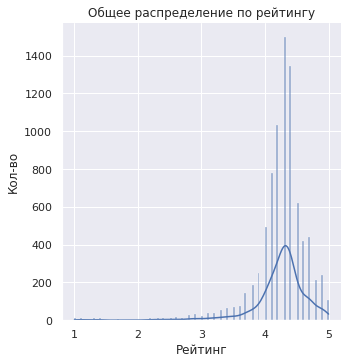

In [32]:
#визуализируем общее распределение среднего рейтинга

sns.displot(x='rating', kde=True, data=df)
plt.title('Общее распределение по рейтингу')
plt.xlabel('Рейтинг')
plt.ylabel('Кол-во')
plt.show()

**Самые распространенные рейтинги 4.2 и 4.3**

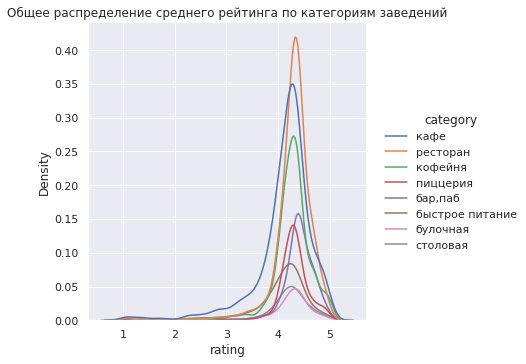

In [33]:
#визуализируем распределение средних рейтингов по категориям заведений

sns.displot(x='rating', hue='category', kind='kde', data=df)
plt.title('Общее распределение среднего рейтинга по категориям заведений')
plt.show()

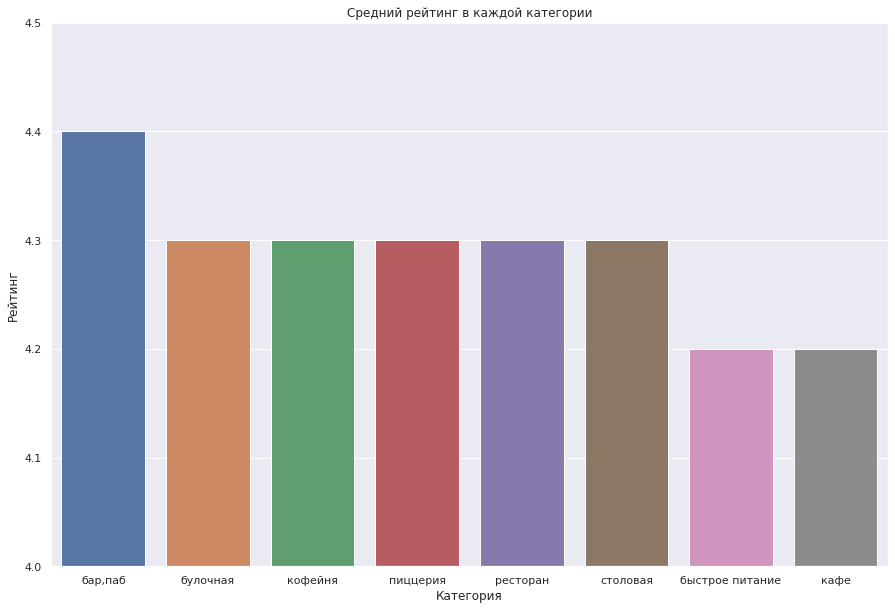

In [34]:
#построим столбчатый график по среднему рейтингу в каждой категории

df_rating_category = (
    df.groupby('category', as_index=False)['rating']
    .agg('median')
    .sort_values(by='rating', ascending=False)
)
sns.barplot(data=df_rating_category, x='category', y='rating')
plt.title('Средний рейтинг в каждой категории')
plt.xlabel('Категория')
plt.ylabel('Рейтинг')
plt.ylim(4, 4.5)
plt.show()

**Cамый высокий рейтинг у Баров/Пабов, кроме заведений Быстрого питания все остальные категории имеют схожие результаты**

In [35]:
rating_df = df.groupby('district', as_index=False)['rating'].agg('median')
rating_df

,district,rating
0,Восточный административный округ,4.3
1,Западный административный округ,4.3
2,Северный административный округ,4.3
3,Северо-Восточный административный округ,4.2
4,Северо-Западный административный округ,4.3
5,Центральный административный округ,4.4
6,Юго-Восточный административный округ,4.2
7,Юго-Западный административный округ,4.3
8,Южный административный округ,4.3


In [36]:
with open('/datasets/admin_level_geomap.geojson', 'r') as f:
    geo_json = json.load(f)

state_geo = '/datasets/admin_level_geomap.geojson'
moscow_lat, moscow_lng = 55.751244, 37.618423

In [37]:
#построим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района

m = Map(location=[moscow_lat, moscow_lng], zoom_start=9.5)
marker_cluster = MarkerCluster().add_to(m)

Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

df.apply(create_clusters, axis=1)

m

**-  лидеры по категориям: пиццерии, рестораны и бары/пабы**

**-  ЦАО - топ среди районов**


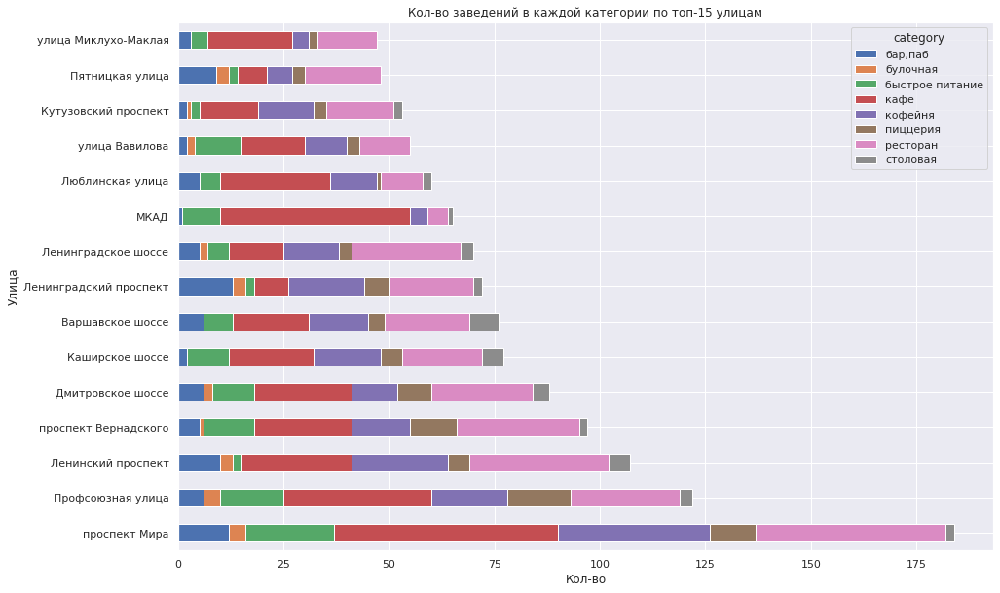

In [38]:
#найдем топ-15 улиц и посмотрим в разрезе по категориям

street_top_15 = (
    df.groupby('street')
    .agg({'name': 'count'})
    .sort_values(by='name', ascending=False)
    .head(15)
    .index
)

(
    df.query('street in @street_top_15')
    .pivot_table(index='street', columns='category', values='name', aggfunc='count')
    .reindex(index=street_top_15)
    .plot(kind='barh', stacked=True)
)
plt.title('Кол-во заведений в каждой категории по топ-15 улицам')
plt.xlabel('Кол-во')
plt.ylabel('Улица')
plt.show()

**На улицах больше всего кафе, ресторанов и кофеен**

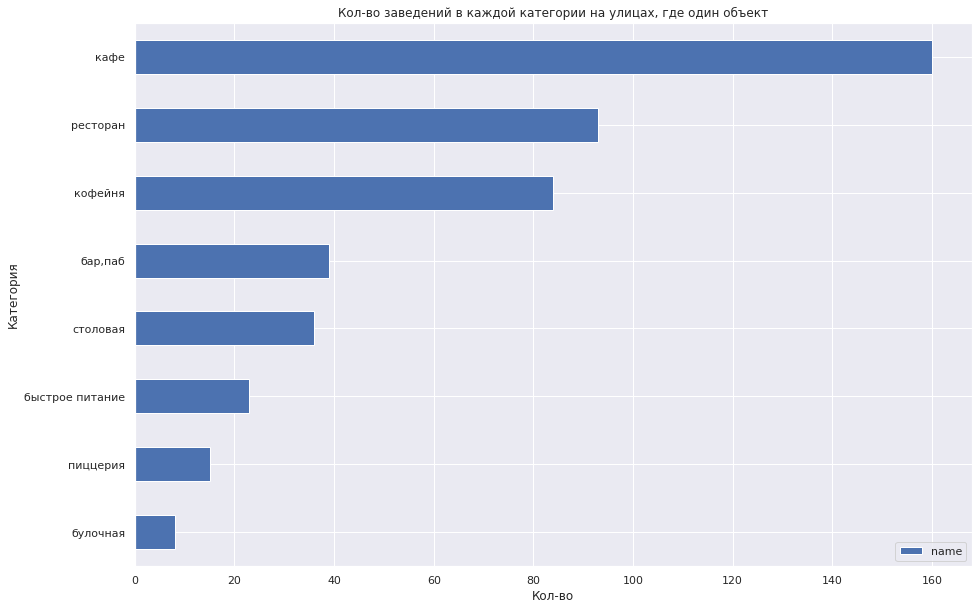

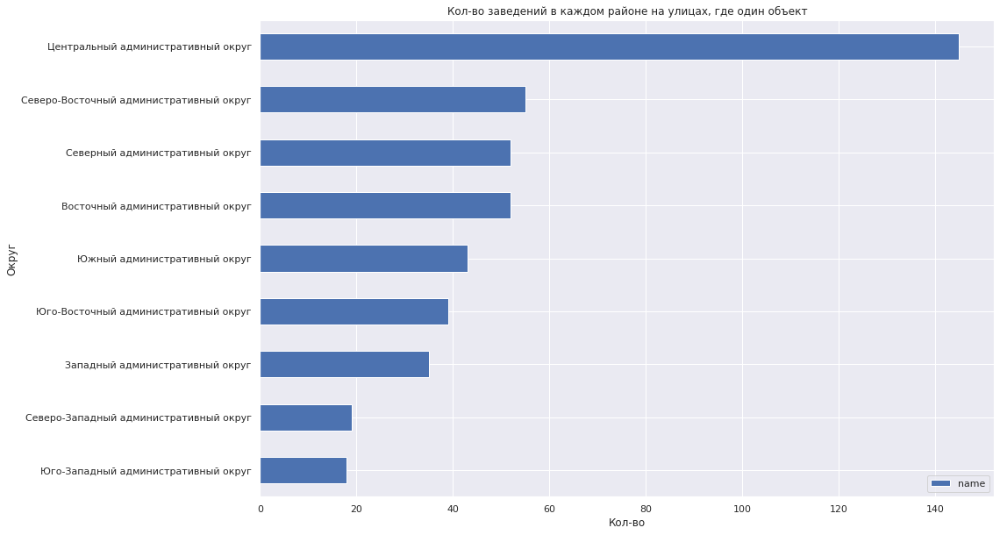

In [39]:
#найдем улицы, на которых находится только один объект общепита

street_alone = (
    df.groupby('street')
    .agg({'name': 'count'})
    .sort_values(by='name', ascending=False)
    .query('name == 1')
    .index
)

#по категориям

(
    df.query('street in @street_alone')
    .pivot_table(index='category', values='name', aggfunc='count')
    .sort_values(by='name')
    .plot(kind='barh')
)
plt.title('Кол-во заведений в каждой категории на улицах, где один объект')
plt.xlabel('Кол-во')
plt.ylabel('Категория')
plt.show()

#по районам

(
    df.query('street in @street_alone')
    .pivot_table(index='district', values='name', aggfunc='count')
    .sort_values(by='name')
    .plot(kind='barh')
)
plt.title('Кол-во заведений в каждом районе на улицах, где один объект')
plt.xlabel('Кол-во')
plt.ylabel('Округ')
plt.show()

**на улицах c одним заведением все те же категроии: кафе, рестораны, кофейни и большинство их в ЦАО**

In [40]:
#посчитаем медиану средних чеков заведений из столбца `middle_avg_bill` для каждого района

df_middle_avg_bill = df[df['middle_avg_bill'] != 9999]
district_avg_bill = df.query('middle_avg_bill != 9999').groupby('district'). agg({'middle_avg_bill':'median'}).reset_index()

In [41]:
district_avg_bill 

,district,middle_avg_bill
0,Восточный административный округ,550.0
1,Западный административный округ,1000.0
2,Северный административный округ,650.0
3,Северо-Восточный административный округ,500.0
4,Северо-Западный административный округ,700.0
5,Центральный административный округ,1000.0
6,Юго-Восточный административный округ,450.0
7,Юго-Западный административный округ,600.0
8,Южный административный округ,500.0


In [42]:
#построим фоновую картограмму с медианным средним чеком заведения в каждом районе

y = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(y)

Choropleth(
    geo_data=state_geo,
    data=district_avg_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный средний чек заведения по районам',
).add_to(y)

def create_clust(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['district']} {row['middle_avg_bill']}",
    ).add_to(marker_cluster)

df_middle_avg_bill.apply(create_clust, axis=1)

y

<b>ЦАО - центр Москвы, а в центре как и во всех городах гуляет, работает огромное кол-во людей. За счет этого, тут и много заведений, а из-за большой конкуренции им нужно держать уровень обслуживания, качество блюд, разнообразие и т.д. От качесва и рейтинг растет и средний чек заведения.</b>

**Топ районов по среднему чеку: ЦАО, ЗАО и СЗАО. В хвосте: ЮВАО, СВАО и ЮАО**

In [43]:
#посчитаем медиану средних чеков заведений из столбца `middle_avg_bill` для каждой категории заведения

category_avg_bill = (
    df.query('middle_avg_bill != 9999')
    .groupby('category')
    .agg({'middle_avg_bill':'median'})
    .reset_index()
    .sort_values(by='middle_avg_bill', ascending=False)
)

In [44]:
category_avg_bill

,category,middle_avg_bill
0,"бар,паб",1250.0
6,ресторан,1250.0
5,пиццерия,600.0
3,кафе,550.0
1,булочная,450.0
4,кофейня,400.0
2,быстрое питание,375.0
7,столовая,300.0


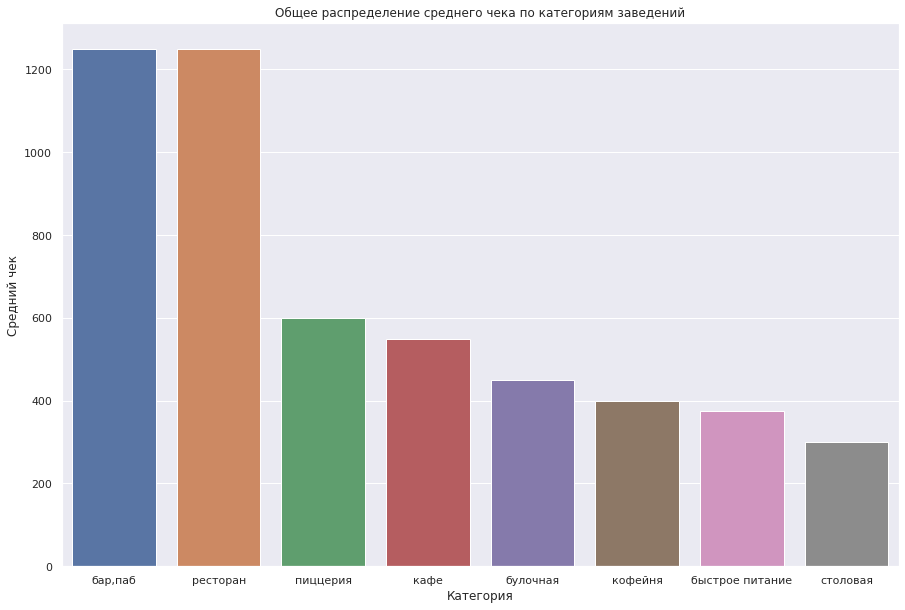

In [45]:
#визуализируем распределение среднего чека по категориям заведений

sns.barplot(data=category_avg_bill, x='category', y='middle_avg_bill') 
plt.title('Общее распределение среднего чека по категориям заведений')
plt.xlabel('Категория')
plt.ylabel('Средний чек')
plt.show()

**- лидеры по категориям: пиццерии, рестораны и бары/пабы**

**- ЦАО, ЗАО и СЗАО в топе**


# <a id="4"></a>**Шаг 4. Вывод и рекомендации**

[Оглавление](#Head)

**Вывод:**

 **- лидеры в категориях по кол-ву заведений, рейтингу и среднему чеку: кафе, кофейни, пиццерии, рестораны и бары/пабы**
 
 **- ниша кофеен и пиццерий занята сетевыми заведениями**
 
 **- ниша рестораны, бары/пабы и кафе занята несетевыми заведениями**
 
 **- рынок на 60% состоит из несетевых заведений**
 
 **- ЦАО - топ среди районов, но и ЗАО, СЗАО и САО, отлично себя показывают по охвату, рейтингу и среднему чеку**

**Рекомедации:**

**1. «Shut Up and Take My Money» предлагаю открыть сетевые заведения в категориях: Бар/Паб и кофейня.**

**Кофеен довольно много, конкуренция с сетевыми и с несетевыми заведениями, а т.к. рейтинг не высокий, то есть место где разгуляться, например: готовить кофе из более качественных сортов, сопутствующие товары (круассаны, сэндвичи, десерты) закупать у проверенных поставщиков.
Меню: КОФЕ, чай, напитки (вода бутилированая), выпечка и десерты. Средний чек - 300 руб.**

**В проведенном анализе, в категории Барам/Пабам видна перспектива, низкая конкуренция с сетевыми заведениями, высокий рейтинг, хороший средний чек.
Меню не отличается большим разнообразием, но можно придумать блюдо от шефа: Пиво, различный алкоголь, закуски, вторые блюда: мясо\рыба с гарниром, бургеры. Средний чек - 1000 руб.**



**2. ЦАО, ЗАО, СЗАО и САО - районы в которых можно открываться, они хорошо себя показали и по рейтингу, и по среднему чеку.**

# <a id="5"></a>**Шаг 5. Детализировать исследование: открытие кофейни**

[Оглавление](#Head)

In [46]:
#проанализируем сколько всего кофеен в датасете. В каких районах их больше всего, каковы особенности их расположения

print('Всего кофеен -', df[df['category'] == "кофейня"]['category'].count())

Всего кофеен - 1401


In [47]:
df_coffee = df[df['category'] == "кофейня"]
coffee_cnt_district = df_coffee.groupby('district'). agg({'name':'count'}).reset_index()
coffee_cnt_district

,district,name
0,Восточный административный округ,104
1,Западный административный округ,146
2,Северный административный округ,186
3,Северо-Восточный административный округ,159
4,Северо-Западный административный округ,62
5,Центральный административный округ,428
6,Юго-Восточный административный округ,89
7,Юго-Западный административный округ,96
8,Южный административный округ,131


In [48]:
#построим фоновую картограмму по кол-ву кофеен

w = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(w)

Choropleth(
    geo_data=state_geo,
    data=coffee_cnt_district,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Кол-во кофеен в каждом районе',
).add_to(w)

def create_cluster(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['district']} {row['name']}",
    ).add_to(marker_cluster)

df_coffee.apply(create_cluster, axis=1)

w

**Большинство кофеен в ЦАО, САО, ЗАО и СВАО**

In [49]:
#посмотрим долю круглосуточных кофеен

print('Доля круглосуточных кофеен -', round(df[(df['category'] == 'кофейня') & (df['is_24/7'] == True)]['name'].count()/df[df['category'] == 'кофейня']['name'].count(), 2))

Доля круглосуточных кофеен - 0.04


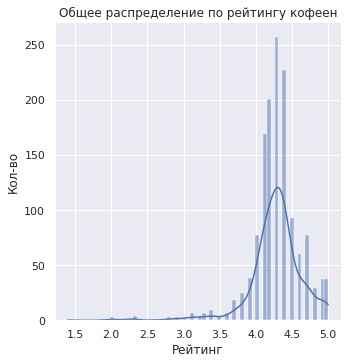

In [50]:
#проанализируем рейтинг кофеен

sns.displot(x='rating', kde=True, data=df_coffee)
plt.title('Общее распределение по рейтингу кофеен')
plt.xlabel('Рейтинг')
plt.ylabel('Кол-во')
plt.show()

**Самый распространенный рейтинг - 4.3**

In [51]:
#проанализируем рейтинг кофеен по районам

rating_df_coffee = (
    df_coffee.groupby('district', as_index=False)['rating']
    .agg('median')
    .sort_values(by='rating', ascending=False)
                   )
rating_df_coffee

,district,rating
0,Восточный административный округ,4.3
2,Северный административный округ,4.3
3,Северо-Восточный административный округ,4.3
4,Северо-Западный административный округ,4.3
5,Центральный административный округ,4.3
6,Юго-Восточный административный округ,4.3
7,Юго-Западный административный округ,4.3
8,Южный административный округ,4.3
1,Западный административный округ,4.2


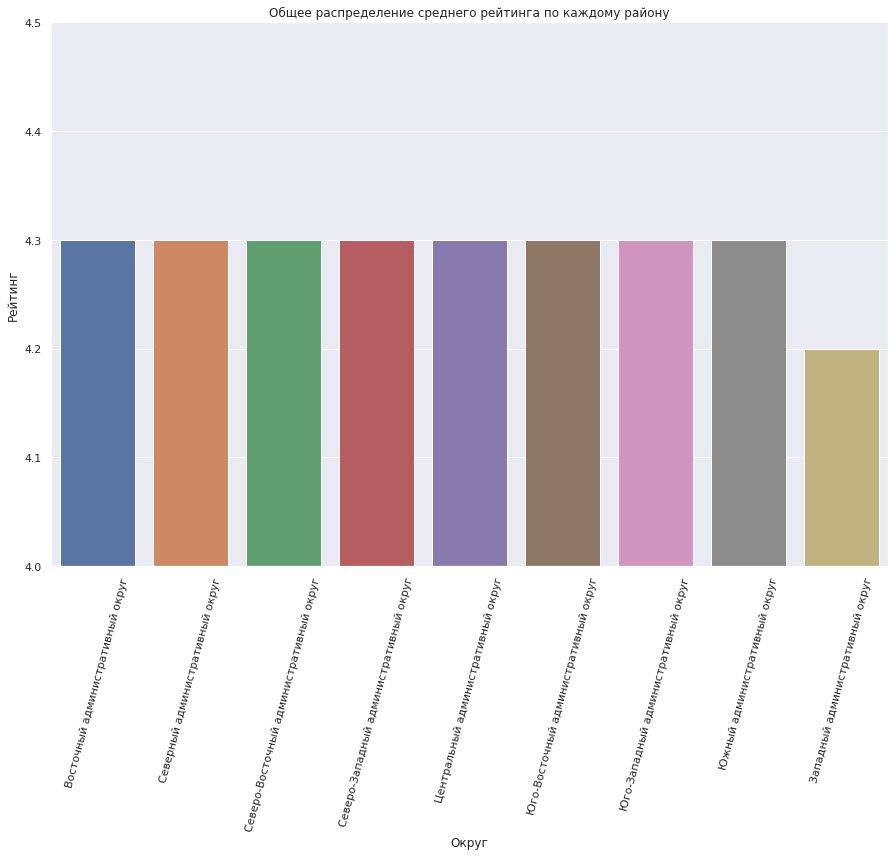

In [52]:
sns.barplot(data=rating_df_coffee, x='district', y='rating') 
plt.title('Общее распределение среднего рейтинга по каждому району')
plt.xlabel('Округ')
plt.ylabel('Рейтинг')
plt.ylim(4, 4.5)
plt.xticks(rotation = 75)
plt.show()

**Все районы имеют схожий рейтинг, кроме ЗАО**

In [53]:
print('Средняя стоимость чашки кофе -', df[df['category']=='кофейня']['middle_coffee_cup'].median())

Средняя стоимость чашки кофе - 170.0


**Средняя стоимость чашки кофе - 170 руб., при среднем чеке в 400 руб.**

In [54]:
#средняя стоимость чашки по районам

(
    df.groupby('district')
    .agg({'middle_coffee_cup':'median'})
    .reset_index()
    .sort_values(by='middle_coffee_cup', ascending=False)
)

,district,middle_coffee_cup
7,Юго-Западный административный округ,197.0
5,Центральный административный округ,190.0
1,Западный административный округ,185.0
3,Северо-Восточный административный округ,162.5
2,Северный административный округ,159.0
4,Северо-Западный административный округ,150.0
8,Южный административный округ,149.5
6,Юго-Восточный административный округ,145.0
0,Восточный административный округ,135.0


**Вывод:**

**- Большинство кофеен в ЦАО, САО, ЗАО, СВАО**

**- у 4% заведений круглосуточный режим**

**- Средняя стоимость чашки кофе - 170 руб., при среднем чеке в 400 руб.**

**Рекомендации:**

**1. Можно открыть круглосуточную кофейню в центре города, т.к. таких кофеен там мало.** 

**2. Средняя стоимость чашки кофе на старте - 150 руб, а средний чек - 300 руб., что ниже, чем сейчас. Всё для привлечения клиентов.**

# <a id="6"></a> **Шаг 6. Презентация**

[Оглавление](#Head)

Ссылка: https://disk.yandex.ru/i/2jG_BEnEDEwkug